In [97]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from PIL import Image

In [58]:
cam_matrix = np.array([[525. ,   0. , 319.5],
       [  0. , 525. , 239.5],
       [  0. ,   0. ,   1. ]])
trans_depth_rgb = np.array([-0.025000000000000015, 0.0, 1.224020884649235e-13])
rot_depth_rgb = np.array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]])

trans_baselink_rgb = np.array([-0.012499999999574012, 0.28700000000042597, 0.08699999999865589])
rot_baselink_rgb = np.array([[ 4.89630558e-12, -1.00000000e+00,  0.00000000e+00],
 [ 4.89641661e-12, -2.22044605e-16, -1.00000000e+00],
 [ 1.00000000e+00,  4.89641661e-12,  4.89630558e-12]])

rot_rgb_baselink = rot_baselink_rgb.T
trans_rgb_baselink = - rot_baselink_rgb.T @ trans_baselink_rgb

rot_depth_baselink = rot_rgb_baselink
trans_depth_baselink = rot_rgb_baselink @ trans_depth_rgb + trans_rgb_baselink

In [53]:
files = [f.replace('-points.npy', '') for f in glob.glob('*.npy')]

points = [np.load(f+'-points.npy') for f in files]
images = [cv2.imread(f+'.jpg') for f in files]
masks = [cv2.imread(f+'-masked.jpg') for f in files]


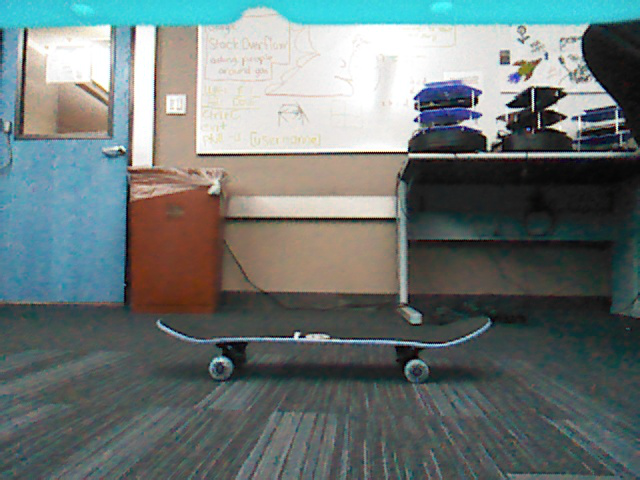
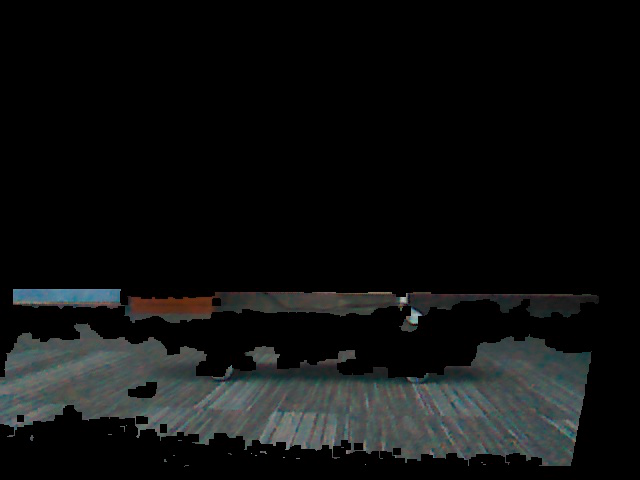

In [75]:
px.imshow(np.array([images[3], masks[3]]), facet_col=0)

In [77]:
pt = points[3]

fig = px.scatter_3d(x=pt[0], y=pt[1], z=pt[2])
fig.show()

In [80]:
transformed_pts = []
for p in pt.T:
    transformed_pts.append(rot_depth_baselink @ p + trans_depth_baselink)
transformed_pts = np.array(transformed_pts).T

fig = px.scatter_3d(x=transformed_pts[0], y=transformed_pts[1], z=transformed_pts[2])
fig.show()

In [70]:
def project_points(points, cam_matrix, trans, rot):
    points = np.dot(rot, points) + np.array(trans).reshape((3, 1))
    homo_pixel_coords = np.dot(cam_matrix, points)
    pixel_coords = homo_pixel_coords[0:2, :] / homo_pixel_coords[2, :]
    pixel_coords = np.floor(pixel_coords).astype('int32')
    return pixel_coords

pixel_coords = project_points(pt, cam_matrix, trans_depth_rgb, rot_depth_rgb)
px.scatter(x=pixel_coords[0], y=pixel_coords[1], color=pt[2])


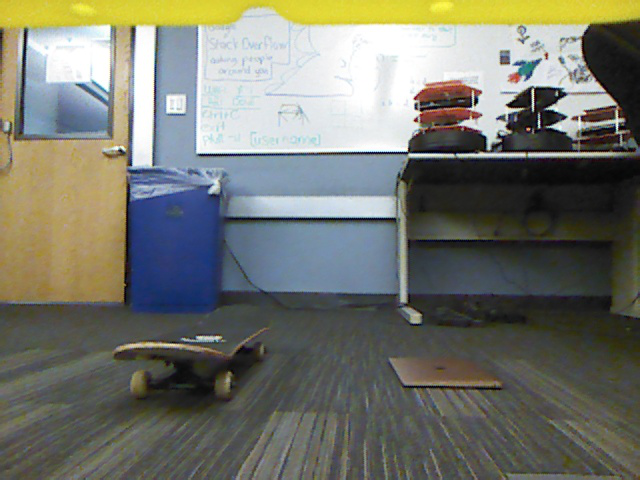

In [134]:

p_images = []
texts = []
for x in np.arange(0, 3, 0.5):
    for y in np.arange(-2, 3, 0.5):
        p_baselink = np.array([x, y, 0])
        p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb
        p_depth = p_rgb - trans_depth_rgb
        
        p_image = project_points(np.expand_dims(p_depth, 0).T, cam_matrix, trans_depth_rgb, rot_depth_rgb)
        p_image = p_image.T[0]
        
        if p_image[0] < 0 or p_image[1] < 0 or p_image[0] > 640 or p_image[1] > 480:
            continue
        p_images.append(p_image)
        texts.append(f'{x}, {y}')
        
p_images = np.array(p_images)

fig = px.scatter(x=p_images[:,0], y=p_images[:,1], text=texts)

fig.update_xaxes(range=[0, 640], showgrid=False)
fig.update_yaxes(range=[480, 0], showgrid=False)

fig.add_layout_image(
        dict(
            source=Image.open(files[2]+'.jpg'),
            xref="paper", yref="paper", x=0, y=1,
            xanchor="left", yanchor="top", layer="below",
            sizing="stretch", sizex=1.0, sizey=1.0,
            opacity=0.8)
)
fig.update_layout(template="plotly_dark")

fig.update_traces(textposition='top center')
fig.show()

In [162]:
rectangle = [[1.5, 0.5], [1.5, 0], [1, 0], [1, 0.5]]
dest = [[0,0], [100, 0], [100, 100], [0, 100]]

rect_image = []
for (x,y) in rectangle:
    p_baselink = np.array([x, y, 0])
    p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb
    p_depth = p_rgb - trans_depth_rgb

    p_image = project_points(np.expand_dims(p_depth, 0).T, cam_matrix, trans_depth_rgb, rot_depth_rgb)
    p_image = p_image.T[0]
    rect_image.append(p_image)
    
print(rect_image)
rect_image = np.array(rect_image)
dest = np.array(dest)

[array([149, 334], dtype=int32), array([315, 334], dtype=int32), array([313, 378], dtype=int32), array([ 71, 378], dtype=int32)]



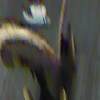

In [163]:
matrix, _ = cv2.findHomography(rect_image, dest)
warped = cv2.warpPerspective(images[2], matrix, (100, 100))
px.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))

[array([114, 297], dtype=int32), array([519, 297], dtype=int32), array([1202,  496], dtype=int32), array([-587,  496], dtype=int32)]



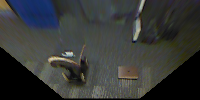

In [187]:
DEPTH_MAX = 2.5
DEPTH_MIN = 0.5

RANGE = 1.0

rectangle = [[DEPTH_MAX, RANGE], [DEPTH_MAX, -RANGE], [DEPTH_MIN, -RANGE], [DEPTH_MIN, RANGE]]

W = 200
H = 100
dest = [[0,0], [W, 0], [W, H], [0, H]]

rect_image = []
for (x,y) in rectangle:
    p_baselink = np.array([x, y, 0])
    p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb
    p_depth = p_rgb - trans_depth_rgb

    p_image = project_points(np.expand_dims(p_depth, 0).T, cam_matrix, trans_depth_rgb, rot_depth_rgb)
    p_image = p_image.T[0]
    rect_image.append(p_image)
    
print(rect_image)
rect_image = np.array(rect_image).astype(np.float32)
dest = np.array(dest).astype(np.float32)

matrix = cv2.getPerspectiveTransform(rect_image, dest)
warped = cv2.warpPerspective(images[2], matrix, (W, H))
warped_img = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)
warped_img = Image.fromarray(warped_img)

px.imshow(warped_img)


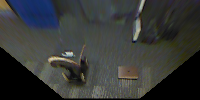

In [188]:

p_images = []
texts = []
for x in np.arange(0, 3, 0.5):
    for y in np.arange(-2, 3, 0.5):
        p_baselink = np.array([x, y, 0])
        p_rgb = rot_baselink_rgb @ p_baselink + trans_baselink_rgb
        p_depth = p_rgb - trans_depth_rgb
        
        p_image = project_points(np.expand_dims(p_depth, 0).T, cam_matrix, trans_depth_rgb, rot_depth_rgb)
        p_image = p_image.T[0]
        
        p_image = matrix @ np.array([p_image[0], p_image[1], 1])
        p_image /= p_image[2]
        
        if p_image[0] < 0 or p_image[1] < 0 or p_image[0] > 640 or p_image[1] > 480:
            continue
        p_images.append(p_image[:2])
        texts.append(f'{x}, {y}')
        
p_images = np.array(p_images)

fig = px.scatter(x=p_images[:,0], y=p_images[:,1], text=texts)

fig.update_xaxes(range=[0, W], showgrid=False)
fig.update_yaxes(range=[H, 0], showgrid=False)

fig.add_layout_image(
        dict(
            source=warped_img,
            xref="paper", yref="paper", x=0, y=1,
            xanchor="left", yanchor="top", layer="below",
            sizing="stretch", sizex=1.0, sizey=1.0,
            opacity=0.8)
)
fig.update_layout(template="plotly_dark")

fig.update_traces(textposition='top center')
fig.show()